# Health of NYC citizens based on air pollution and trees

- toc: false
- author: Alex Oláh & Klaudia Tóth & Máté Cseke András
- categories: [environment, social-data, analysis, air-pollution, health]

In [2]:
#hide
from folium import plugins
from folium.plugins import HeatMap
from sklearn.preprocessing import MinMaxScaler
from matplotlib.ticker import MaxNLocator

import pandas as pd
import folium
import plotly.offline as poff
import plotly.express as px
import json
import seaborn as sn
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
import math
import branca
import branca.colormap as cm
from IPython.display import display, HTML
import plotly.io as pio
#pio.renderers.default = 'iframe'

import warnings
warnings.filterwarnings('ignore')

In [3]:
#hide
__dir__ = ''

air_quality_311 = pd.read_csv(__dir__ + '311_air_quality.csv', parse_dates=True)
tree_data_2005 = pd.read_csv(__dir__ + '2005_Street_Tree_Census.csv')
tree_data_2015 = pd.read_csv(__dir__ + '2015_Street_Tree_Census_-_Tree_Data.csv')
air_quaility_data = pd.read_csv(__dir__ + 'Air_Quality.csv', parse_dates=True)
health_surveys = pd.read_csv(__dir__ + 'New_York_City_Community_Health_Survey.csv')

<p align="center">
  <img src="https://oxynow.net/wp-content/uploads/2022/02/Air-Pollution.jpeg" />
</p>

For ages it has been a consistent topic that we are getting further and further away from nature and how it is affecting our lifestyles and health. There has been many researches on this topic and it was always clear that environmental factors do play a huge role in our life and well-being. In recent years there has been an increasing effort in maintaining and bringing back a green environment to places which were struggling in that regard. Not surprisingly the most affected areas by this problem are cities and heavily industrialized towns. Even though it is very prevalent now how much of an effect environmental factors have on health many people still have to live under detrimental circumstances. Many different factors contribute to a healthy environment, including the quality of air, noise levels, light pollution and last but not least the amount of nature (trees, plants, lakes etc.) an area has. Some of these factors have possible direct influence on others just as the amount of nature usually indicates better air quality as well. 

The main goal of this project is to get some insights on exactly how much the well-being of citizens is affected by environmental factors and if people living in lower-income areas are in a worse position regarding the access to healthy living environments. We also want to see if the recently promised advancements towards fixing these problems have actually proved to be successful and beneficial.

We thus would like to take the reader on a small journey where we can hopefully show them how much nature actually matters in our every day lives.

Our focus will solely be on New York City for a few reasons:
- New York City has a fairly developed data platform which is open for the public and contains important datasets like air quality surveillance, collection of anonimized 311 report and poverty, and tree distribution data.
- It's also one of the most environmentally green cities in the world with approx. 57% of it's area being covered in some kind of nature.
- Last but not least it is one of the biggest and most diverse cities in the world making it a good target for research.


We are going to analyze New York City data both from a social and an enviromental aspect, by using the previously mentioned data on trees, air pollution, 311 complaints and poverty, to see what effects they have on one another. The observed period of time is between 2005 and 2015, let's jump right into it. First let's have a look at the number of air quality related complaints over the years. But why air quality?

Air pollution is one of the most important environmental threats to urban populations and while all people are exposed, pollutant emissions, levels of exposure, and population vulnerability vary across neighborhoods. Exposures to common air pollutants have been [linked to respiratory and cardiovascular diseases, cancers, and premature deaths](https://ehp.niehs.nih.gov/doi/full/10.1289/ehp.1103639).

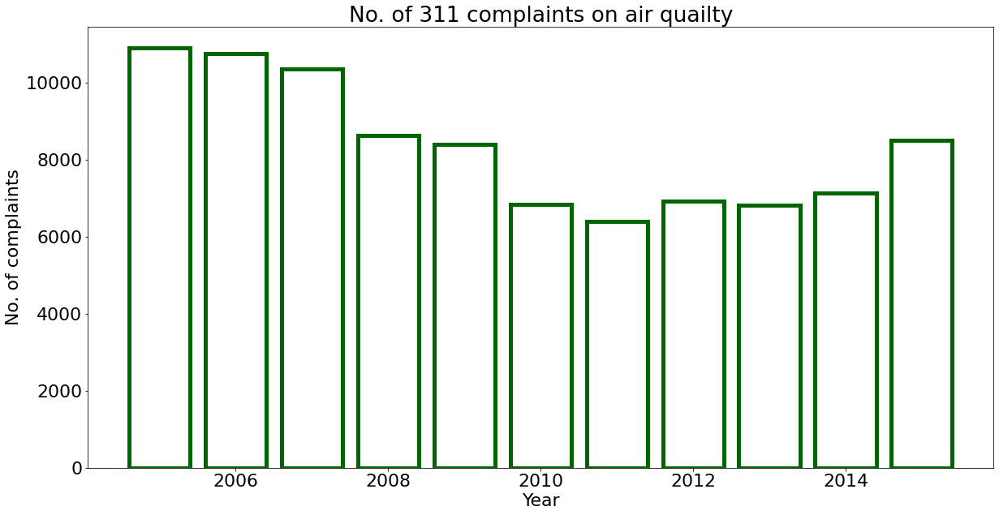

In [4]:
#hide_input
air_quality_311['Created Date'] = pd.to_datetime(air_quality_311['Created Date'])
_air_quality_311 = air_quality_311[air_quality_311['Created Date'].dt.year <= 2015]

air_quality_311_by_year = _air_quality_311.groupby(_air_quality_311['Created Date'].dt.year).size()
plt.rcParams.update({'font.size': 22})
ax = plt.figure(figsize=(20,10)).gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
plt.bar(air_quality_311_by_year.index, air_quality_311_by_year, color='white', edgecolor = 'darkgreen', linewidth=5)
plt.title('No. of 311 complaints on air quailty')
plt.xlabel('Year')
plt.ylabel('No. of complaints')
plt.savefig("311_year_airquality.png")
plt.show()

And for completeness' sake let's have a look at it using geospatial analysis.

In [5]:
#hide_input
complaint_map = folium.Map(location=[40.730610, -73.935242], zoom_start=11, tiles="Stamen Toner")

air_quality_311_for_map = air_quality_311.dropna(axis=0, subset=['Longitude','Latitude'])

complaints = [[[row['Latitude'], row['Longitude']] for _, row in air_quality_311_for_map[air_quality_311_for_map['Created Date'].dt.year == year].iterrows()] for year in range(2005,2016)]
complaint_heatmap = plugins.HeatMapWithTime(complaints, index=[x for x in range(2005, 2016)], auto_play=True, radius=5, min_opacity=0.05, max_opacity=0.9)
complaint_heatmap.add_to(complaint_map)
complaint_map.save("complaint_map.html")
display(HTML(filename="complaint_map.html"))

It would be too early to deduce any sort of conclusions from these alone, let alone say that nothing has changed over the years. First let's dive a little bit deeper into what 311 requests are: [311](https://ouc.dc.gov/page/311-city-services) is a toll-free number that allows people in the District to request assistance with city services and information. Because it is easy to use and easy to remember, 311 can help improve service delivery to residents, workers, and visitors in the nation's capital.

So anybody who asks for assistance or just wants to query information can call this number. What other aspects are contained within the data? Well most often than not the requests are for air quality issues, like odor, fumes, dust and smoke (see the plot below). So does this mean anything?

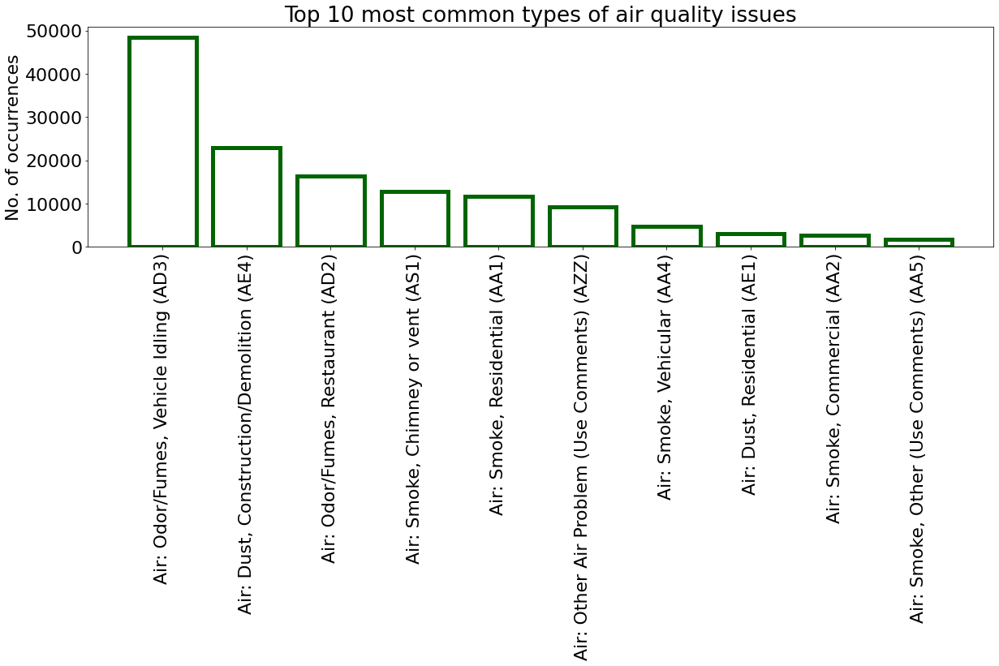

In [6]:
#hide_input
descriptors = air_quality_311.groupby(air_quality_311['Descriptor']).size().sort_values(ascending=False).head(10)
ax = plt.figure(figsize=(20,5)).gca()
plt.bar(descriptors.index, descriptors, color='white', edgecolor = 'darkgreen', linewidth=5)
plt.title('Top 10 most common types of air quality issues')
plt.ylabel('No. of occurrences')
plt.xticks(rotation=90)
plt.savefig("air_issue.png")
plt.show()

Health surveys of New york City citizens are available since 2010. We can take a look at the correlation between the number of air quality related 311 requests and the self-reported health status. What we can see is that there is a low negative correlation between them (-0.3611), meaning that an increase in the number of requests slightly influences people's self-reported health negatively.

In [7]:
#hide_input
health_by_prevelance = health_surveys[health_surveys['Year'] <= 2015][health_surveys['Prevelance'].str.contains("Prevalence")]
for_corr_311 = air_quality_311_by_year[air_quality_311_by_year.index >= 2010]

# We need to reverse the list, because the order of the years are reversed
health_by_prevelance.insert(1, 'Number of air quality issues', list(reversed(for_corr_311.values)))
health_by_prevelance.corr(method='pearson')['Number of air quality issues']['Self-reported Health Status (excellent/very good/good)']


-0.36113510837759755

Well this doesn't say much. How about we introduced a new kind of dataset? Instead of looking at reports let's look at actual measurements of NYC. The air quality dataset contains information on New York City air quality surveillance data. These indicators provide a perspective across time and NYC geographies to better characterize air quality and health.

So how about different chemical concentrations in the air? Two pollutants, particulate matter and ground-level ozone, are of particular health concern, so we'll reduce the area of observations to only these two metritcs.

In [8]:
#hide_input
from IPython.display import display_html, HTML, display
# ez mukszik csak nem deepnote-on
with open(__dir__ + 'community_districts.geojson') as f:
    districts = json.load(f)

# round off, to reduce file size
for i in range(0, len(districts["features"])):
    for j in range(0,len(districts["features"][i]['geometry']['coordinates'])):
        try:
            districts["features"][i]['geometry']['coordinates'][j] = np.round(np.array(districts["features"][i]['geometry']['coordinates'][j]),3)
        except:
            #print(i,j)
            pass

aspects = [
    'Fine Particulate Matter (PM2.5)',
    'Ozone (O3)'
]

all_map_data = {}
air_quaility_data['Start_Date'] = pd.to_datetime(air_quaility_data['Start_Date'])

for aspect in aspects:
    data = air_quaility_data[air_quaility_data['Name'] == aspect][air_quaility_data['Geo Type Name'] == 'CD']
    map_data = pd.DataFrame(columns=['cd',aspect,'year'])

    map_data['cd'] = data['Geo Join ID']
    map_data[aspect] = data['Data Value']
    map_data['year'] = data['Start_Date'].dt.year

    all_map_data[aspect] = map_data

for key, map_data in all_map_data.items():
    max_value = map_data[key].max()
    fig = px.choropleth_mapbox(map_data, geojson=districts,
                      locations='cd', 
                      color=key,
                      color_continuous_scale='aggrnyl' if key == 'Ozone (O3)' else 'agsunset',
                      range_color=(0, max_value),
                      featureidkey="properties.BoroCD",
                      mapbox_style="stamen-toner",
                      opacity=0.8,
                      center = {"lat": 40.730610, "lon": -73.935242}, 
                      zoom=9,
                      animation_frame='year',
                      title=key)

    fig.update_geos(fitbounds="locations",visible=False)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},)
    conc_plot = pio.to_html(fig, include_plotlyjs=False)
    display(HTML(conc_plot))

What we can see is that fine particulate matter (PM2.5) is rather high in center of manhattan but relatively low in the outskirts of NYC. The opposite can be said of Ozone (O3) levels. Over the years we can see a rather drastic decrease in PM2.5 but not in O3. Contrary to what we have expected, we can see a very much visible decrease in fine particular matter over the years, especially in the center of manhattan where most of the 311 calls happen. But air pollution related 311 requests were at an all time low in 2011 and peaked again in 2015. Ozone levels did increase in  2010 and were at that level until 2013, from that point which they started drop. So what's the deal with this? Can we assume that 311 related calls are unrelated to fine particles and other air toxics? Let's look at their correlation.

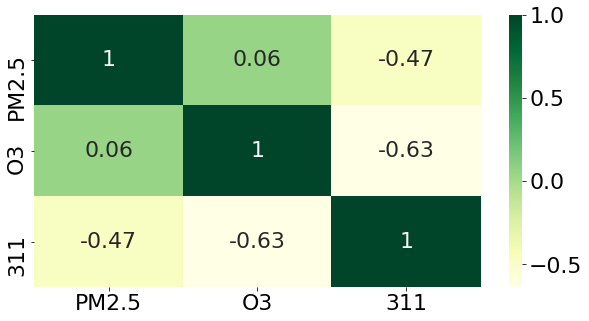

In [9]:
#hide_input
start_year = 2009
end_year = 2015
column_name = '311'

df = pd.DataFrame()
for aspect in aspects:
    data = air_quaility_data[(air_quaility_data['Name'] == aspect) & (air_quaility_data['Start_Date'].dt.year <= end_year) & ((air_quaility_data['Start_Date'].dt.year >= start_year))].groupby(air_quaility_data['Start_Date'].dt.year)['Data Value'].mean()
    df[aspect] = data.to_frame(name=aspect)[aspect]

df[column_name] = air_quality_311[(air_quality_311['Created Date'].dt.year <= end_year) & (air_quality_311['Created Date'].dt.year >= start_year)].groupby(_air_quality_311['Created Date'].dt.year).size().to_frame(name = column_name)[column_name]

df.rename(columns={'Fine Particulate Matter (PM2.5)': 'PM2.5', 'Ozone (O3)': 'O3'}, inplace=True)
fig, ax = plt.subplots(figsize=(10,5)) 
sn.heatmap(df.corr(method='pearson'), annot=True, cmap='YlGn', ax=ax)
plt.savefig("pm_o3_311_corr.png")
plt.show()


So not unrelated, but there is a mild and moderate negative correlation between air quality and the number of 311 calls. Complitely the opposite of what one would expect. Or is it?  It wouldn't make sense to question it were it not for the case that these are micro particles and cannot be seen by the naked eye. Humans are kind of perceptive in a sense that they are only aware of things negatively impacting them if they can actually feel the impact. A person would only report something via the 311 number if they noticed it. Let it be smoke, dust etc etc. Fine particles and Ozone cannot be detected without the capability of measuring them, but they are sure to leave their mark on one's health.

So us, humans, [are mostly unaware of this impact](https://www-tandfonline-com.proxy.findit.cvt.dk/doi/full/10.1080/10810730.2019.1574320), so naturally on the individual's level the problem is rather difficult to solve. Large-scale solutions and raising awareness of these issues are of great importance. 

[New York City’s air quality has improved recently](https://www1.nyc.gov/site/doh/health/health-topics/air-quality-air-pollution-protection.page), as the City and State have worked to lower emissions from regional and local sources. Despite this progress, air pollution remains a leading environmental health threat to all New Yorkers. Those most at risk include older adults, children and people with preexisting health conditions.

So what can we do as a society?

![Tree](https://daily.jstor.org/wp-content/uploads/2020/06/why_you_should_learn_the_names_of_trees_1050x700.jpg)

Well, trees, besides indirectly affecting temperature by being very [good at shading surfaces, reducing temperatures](https://trees-energy-conservation.extension.org/how-do-trees-cool-the-air/) and thus decreasing risk of harmful pollutants like ground level ozone that [commonly spike on hot days in urban areas](https://www.epa.gov/ground-level-ozone-pollution/ground-level-ozone-basics#formation), are rather [potent at removing particulate matter from the air](https://pubs.acs.org/doi/10.1021/acs.est.8b06629). So more trees equals less particles, right? Well let's see that!

[Street tree data from the TreesCount! 2005 and 2015 Street Tree Census](https://data.cityofnewyork.us/Environment/2015-Street-Tree-Census-Tree-Data/uvpi-gqnh), is conducted by volunteers and staff organized by NYC Parks & Recreation and partner organizations. Tree data collected includes tree species, diameter and perception of health. Accompanying blockface data is available indicating status of data collection and data release citywide.

We can check how many more trees there are in certain community districts

In [10]:
#hide_input
datasets = {'cb_num': tree_data_2005, 'community board': tree_data_2015}

for key, dataset in datasets.items():
    data = dataset.groupby(dataset[key]).size().to_frame(name='number').reset_index()
    data['year'] = 2005 if key == 'cb_num' else 2015

    max_value = data['number'].max()
    fig = px.choropleth_mapbox(data, geojson=districts,
                      locations=key, 
                      color='number',
                      color_continuous_scale='greens',
                      range_color=(0, max_value),
                      featureidkey="properties.BoroCD",
                      mapbox_style="stamen-toner",
                      opacity=0.8,
                      center = {"lat": 40.730610, "lon": -73.935242}, 
                      zoom=9)
    fig.update_geos(fitbounds="locations",visible=False)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    com_plot = pio.to_html(fig, include_plotlyjs=False)
    display(HTML(com_plot))

There are two things we can talk about here: there has been an increase in the amount of trees there are all around NYC and that the outer skirts of the city are the dominant ones regarding this number. What is to be expected though, is that if we were to invert the colors of the map it would resemble tha PM2.5 map shown above.
Let's check if they actually correlate.

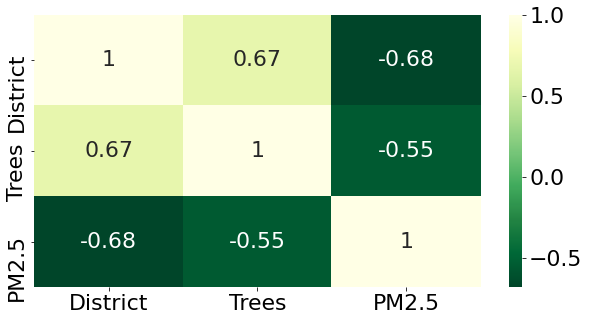

In [11]:
#hide_input
df = tree_data_2015.groupby(tree_data_2015['community board']).size().to_frame(name='Trees').reset_index()

_data = air_quaility_data[air_quaility_data['Name'] == 'Fine Particulate Matter (PM2.5)'][air_quaility_data['Geo Type Name'] == 'CD'][air_quaility_data['Start_Date'].dt.year == 2015]
air_quaility_data_by_cd = _data.groupby(_data['Geo Join ID'])['Data Value'].mean()
df['PM2.5'] = air_quaility_data_by_cd.to_frame(name='pm2.5').reset_index()['pm2.5']

df.rename(columns={'community board': 'District'}, inplace=True)
fig, ax = plt.subplots(figsize=(10,5)) 
sn.heatmap(df.corr(method='pearson'), annot=True, cmap='YlGn_r',ax=ax)
plt.savefig("dist_pm_corr.png")
plt.show()

So what we can see here is that there is a mild negative correlation (namely -0.41) between the amount of trees and the PM2.5, which means that as we increase how many trees there are, PM2.5 is likely to be reduced.

*Fun fact: there is a better indicator of whether or not we live in a place of New York that has less fine particulate matter: as the district number increases, the amount of PM2.5 is likely to be even less. The reason for that might be that higher district numbers are associated with the outer skirts of New York, which are away from traffic.*

We hope this blog post served you some insight in what's acutally happening in the air, how we are naturally unaware of it, 

*"Be a part of the solution, not a part of the pollution"*